# Import Libraries

In [11]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

from sklearn.model_selection import train_test_split

import torch
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms as T
import torchvision
import torch.nn.functional as F
from torch.autograd import Variable

from PIL import Image
import cv2
import albumentations as A

import time
import os
from tqdm.notebook import tqdm

from torchsummary import summary
import segmentation_models_pytorch as smp

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(device)

cuda


# Preprocessing

In [12]:
# from /home/david/Datasets/solar/geospatial/bdappv/

IMAGE_PATH = 'img/google_imgs_w_masks/imgs/'
MASK_PATH = 'img/google_imgs_w_masks/masks/'

In [13]:
n_classes = 2

def create_df():
    name = []
    for dirname, _, filenames in os.walk(IMAGE_PATH):
        for filename in filenames:
            name.append(filename.split('.')[0])
    
    return pd.DataFrame({'id': name}, index = np.arange(0, len(name)))

df = create_df()
print('Total Images: ', len(df))

Total Images:  13303


In [14]:
#split data
X_trainval, X_test = train_test_split(df['id'].values, test_size=0.1, random_state=19)
X_train, X_val = train_test_split(X_trainval, test_size=0.15, random_state=19)

print('Train Size   : ', len(X_train))
print('Val Size     : ', len(X_val))
print('Test Size    : ', len(X_test))

Train Size   :  10176
Val Size     :  1796
Test Size    :  1331


Image Size (400, 400)
Mask Size (400, 400)


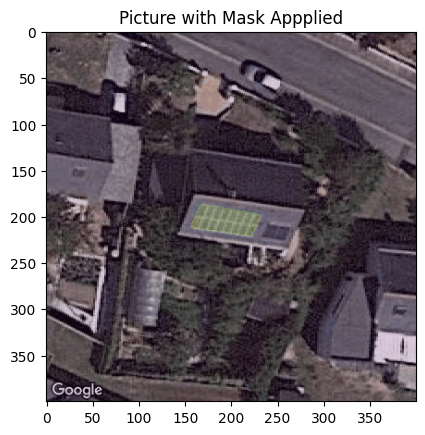

In [15]:
img = Image.open(IMAGE_PATH + df['id'][102] + '.png')
mask = Image.open(MASK_PATH + df['id'][102] + '.png')
print('Image Size', np.asarray(img).shape)
print('Mask Size', np.asarray(mask).shape)


plt.imshow(img)
plt.imshow(mask, alpha=0.2)
plt.title('Picture with Mask Appplied')
plt.show()

# Dataset

In [16]:
class bdappvDataset(Dataset):
    
    def __init__(self, img_path, mask_path, X, mean, std, transform=None, patch=False):
        self.img_path = img_path
        self.mask_path = mask_path
        self.X = X
        self.transform = transform
        #self.patches = patch
        self.mean = mean
        self.std = std
        
    def __len__(self):
        return len(self.X)
    
    def __getitem__(self, idx):
        img = cv2.imread(self.img_path + self.X[idx] + '.png')
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        mask = cv2.imread(self.mask_path + self.X[idx] + '.png', cv2.IMREAD_GRAYSCALE)

        if self.transform is not None:
            aug = self.transform(image=img, mask=mask)
            img = Image.fromarray(aug['image'])
            mask = aug['mask']
        
        if self.transform is None:
            img = Image.fromarray(img)
        
        t = T.Compose([T.ToTensor(), T.Normalize(self.mean, self.std)])
        img = t(img)
        mask = torch.from_numpy(mask).long()
        mask = torch.where(mask<1,0,1)
        
        # if self.patches:
        #     img, mask = self.tiles(img, mask)

        return img, mask
    
    # def tiles(self, img, mask):

    #     img_patches = img.unfold(1, 512, 512).unfold(2, 768, 768) 
    #     img_patches  = img_patches.contiguous().view(3,-1, 512, 768) 
    #     img_patches = img_patches.permute(1,0,2,3)
        
    #     mask_patches = mask.unfold(0, 512, 512).unfold(1, 768, 768)
    #     mask_patches = mask_patches.contiguous().view(-1, 512, 768)
        
    #     return img_patches, mask_patches

In [17]:
"""
# 13303 images in google_imgs_w_masks
img_count = len(df)

def load_img(IMAGE_PATH, df, idx):
    img_path = IMAGE_PATH + df['id'][idx] + '.png'
    #print(img_path)
    img = cv2.imread(img_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    img = Image.fromarray(img)
    return img

# temp accumulators
temp_sum    = np.array([0.0, 0.0, 0.0])
temp_sum_sq = np.array([0.0, 0.0, 0.0])

# sum pixel values by looping through all images
for idx in range(0,img_count):
    image = load_img(IMAGE_PATH, df, idx)
    image = np.array(image)
    image = np.divide(image, 255.)
    #image = image.numpy().transpose(1, 2, 0)
    if image.shape != (400,400,3):
        print('WRONG SIZE!',str(image.shape))

    temp_sum += image.sum(axis = (0, 1))
    temp_sum_sq += (image ** 2).sum(axis = (0, 1))


# count pixels total (3 unique channels)
count = len(df) * 400 * 400

# mean and std
dataset_mean = temp_sum / count
dataset_var  = (temp_sum_sq / count) - (dataset_mean ** 2)
dataset_std  = np.sqrt(dataset_var)
print('mean: ' + str(dataset_mean))
print('std:  ' + str(dataset_std))
"""

"\n# 13303 images in google_imgs_w_masks\nimg_count = len(df)\n\ndef load_img(IMAGE_PATH, df, idx):\n    img_path = IMAGE_PATH + df['id'][idx] + '.png'\n    #print(img_path)\n    img = cv2.imread(img_path)\n    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)\n    img = Image.fromarray(img)\n    return img\n\n# temp accumulators\ntemp_sum    = np.array([0.0, 0.0, 0.0])\ntemp_sum_sq = np.array([0.0, 0.0, 0.0])\n\n# sum pixel values by looping through all images\nfor idx in range(0,img_count):\n    image = load_img(IMAGE_PATH, df, idx)\n    image = np.array(image)\n    image = np.divide(image, 255.)\n    #image = image.numpy().transpose(1, 2, 0)\n    if image.shape != (400,400,3):\n        print('WRONG SIZE!',str(image.shape))\n\n    temp_sum += image.sum(axis = (0, 1))\n    temp_sum_sq += (image ** 2).sum(axis = (0, 1))\n\n\n# count pixels total (3 unique channels)\ncount = len(df) * 400 * 400\n\n# mean and std\ndataset_mean = temp_sum / count\ndataset_var  = (temp_sum_sq / count) - (dataset_

In [18]:
mean=[0.35435794, 0.3582274, 0.31094348]
std=[0.21360262, 0.19732998, 0.19069233]

t_train = A.Compose([A.Resize(400, 400, interpolation=cv2.INTER_NEAREST), 
                     A.HorizontalFlip(), 
                     A.VerticalFlip(), 
                     A.GridDistortion(p=0.2), 
                     A.RandomBrightnessContrast((0,0.5),(0,0.5)),
                     A.GaussNoise()])

t_val = A.Compose([A.Resize(400, 400, interpolation=cv2.INTER_NEAREST), 
                   A.HorizontalFlip(),
                   A.GridDistortion(p=0.2)])

#datasets
train_set = bdappvDataset(IMAGE_PATH, MASK_PATH, X_train, mean, std, t_train, patch=False)
val_set = bdappvDataset(IMAGE_PATH, MASK_PATH, X_val, mean, std, t_val, patch=False)

#dataloader
batch_size = 1

train_loader = DataLoader(train_set, batch_size=batch_size, shuffle=True)
val_loader = DataLoader(val_set, batch_size=batch_size, shuffle=True)

# Model

In [57]:
model = smp.Unet('mobilenet_v2', encoder_weights='imagenet', classes=2, activation=None, encoder_depth=4, decoder_channels=[128, 64, 32, 16]).to(device)

In [56]:
summary(model, (3,400,400))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 32, 200, 200]             864
       BatchNorm2d-2         [-1, 32, 200, 200]              64
             ReLU6-3         [-1, 32, 200, 200]               0
            Conv2d-4         [-1, 32, 200, 200]             288
       BatchNorm2d-5         [-1, 32, 200, 200]              64
             ReLU6-6         [-1, 32, 200, 200]               0
            Conv2d-7         [-1, 16, 200, 200]             512
       BatchNorm2d-8         [-1, 16, 200, 200]              32
  InvertedResidual-9         [-1, 16, 200, 200]               0
           Conv2d-10         [-1, 96, 200, 200]           1,536
      BatchNorm2d-11         [-1, 96, 200, 200]             192
            ReLU6-12         [-1, 96, 200, 200]               0
           Conv2d-13         [-1, 96, 100, 100]             864
      BatchNorm2d-14         [-1, 96, 1

In [21]:
model

Unet(
  (encoder): MobileNetV2Encoder(
    (features): Sequential(
      (0): Conv2dNormActivation(
        (0): Conv2d(3, 32, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
        (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (2): ReLU6(inplace=True)
      )
      (1): InvertedResidual(
        (conv): Sequential(
          (0): Conv2dNormActivation(
            (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=32, bias=False)
            (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
            (2): ReLU6(inplace=True)
          )
          (1): Conv2d(32, 16, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (2): BatchNorm2d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        )
      )
      (2): InvertedResidual(
        (conv): Sequential(
          (0): Conv2dNormActivation(
            (0): Conv2d(16, 96, kernel_size=(1

# Training

In [22]:
def pixel_accuracy(output, mask):
    with torch.no_grad():
        output = torch.argmax(F.softmax(output, dim=1), dim=1)
        temp = torch.add(output,mask)
        correct = torch.where(temp==2,1,0).int()
        #correct = torch.eq(output, mask).int()
        accuracy = float(correct.sum()) / float(mask.sum())
    return accuracy

In [23]:
def mIoU(pred_mask, mask, smooth=1e-10, n_classes=1):
    with torch.no_grad():
        pred_mask = F.softmax(pred_mask, dim=1)
        pred_mask = torch.argmax(pred_mask, dim=1)
        pred_mask = pred_mask.contiguous().view(-1)
        mask = mask.contiguous().view(-1)

        iou_per_class = []
        for clas in [1]: #loop per pixel class
            true_class = pred_mask == clas
            true_label = mask == clas

            if true_label.long().sum().item() == 0: #no exist label in this loop
                iou_per_class.append(np.nan)
            else:
                intersect = torch.logical_and(true_class, true_label).sum().float().item()
                union = torch.logical_or(true_class, true_label).sum().float().item()

                iou = (intersect + smooth) / (union +smooth)
                iou_per_class.append(iou)
        return np.nanmean(iou_per_class)

In [24]:
def get_lr(optimizer):
    for param_group in optimizer.param_groups:
        return param_group['lr']

def fit(epochs, model, train_loader, val_loader, criterion, optimizer, scheduler, patch=False):
    torch.cuda.empty_cache()
    train_losses = []
    val_losses = []

    val_iou = []; val_acc = []
    train_iou = []; train_acc = []

    lrs = []
    min_loss = np.inf
    decrease = 1 ; not_improve=0

    model.to(device)
    fit_time = time.time()
    for e in range(epochs):
        since = time.time()
        running_loss = 0
        iou_score = 0
        accuracy = 0
        #training loop
        model.train()
        for i, data in enumerate(tqdm(train_loader)):
            #training phase
            image_tiles, mask_tiles = data
            # if patch:
            #     bs, n_tiles, c, h, w = image_tiles.size()

            #     image_tiles = image_tiles.view(-1,c, h, w)
            #     mask_tiles = mask_tiles.view(-1, h, w)
            
            image = image_tiles.to(device); mask = mask_tiles.to(device);
            #forward
            output = model(image)
            loss = criterion(output, mask)
            #evaluation metrics
            iou_score += mIoU(output, mask)
            accuracy += pixel_accuracy(output, mask)
            #backward
            loss.backward()
            optimizer.step() #update weight          
            optimizer.zero_grad() #reset gradient
            
            #step the learning rate
            lrs.append(get_lr(optimizer))
            scheduler.step() 
            
            running_loss += loss.item()
            
        else:
            model.eval()
            val_loss = 0
            test_accuracy = 0
            val_iou_score = 0
            #validation loop
            with torch.no_grad():
                for i, data in enumerate(tqdm(val_loader)):
                    #reshape to 9 patches from single image, delete batch size
                    image_tiles, mask_tiles = data

                    # if patch:
                    #     bs, n_tiles, c, h, w = image_tiles.size()

                    #     image_tiles = image_tiles.view(-1,c, h, w)
                    #     mask_tiles = mask_tiles.view(-1, h, w)
                    
                    image = image_tiles.to(device); mask = mask_tiles.to(device);
                    output = model(image)
                    #evaluation metrics
                    val_iou_score +=  mIoU(output, mask)
                    test_accuracy += pixel_accuracy(output, mask)
                    #loss
                    loss = criterion(output, mask)                                  
                    val_loss += loss.item()
            
            #calculatio mean for each batch
            train_losses.append(running_loss/len(train_loader))
            val_losses.append(val_loss/len(val_loader))


            if min_loss > (val_loss/len(val_loader)):
                print('Loss Decreasing.. {:.3f} >> {:.3f} '.format(min_loss, (val_loss/len(val_loader))))
                min_loss = (val_loss/len(val_loader))
                print('saving model...')
                torch.save(model, 'Unet-Mobilenet_v2_mIoU-{:.3f}.pt'.format(val_iou_score/len(val_loader)))
                        

            if (val_loss/len(val_loader)) > min_loss:
                not_improve += 1
                min_loss = (val_loss/len(val_loader))
                print(f'Loss Not Decrease for {not_improve} time')
                if not_improve == 7:
                    print('Loss not decrease for 7 times, Stop Training')
                    break
            
            #iou
            val_iou.append(val_iou_score/len(val_loader))
            train_iou.append(iou_score/len(train_loader))
            train_acc.append(accuracy/len(train_loader))
            val_acc.append(test_accuracy/ len(val_loader))
            print("Epoch:{}/{}..".format(e+1, epochs),
                  "Train Loss: {:.3f}..".format(running_loss/len(train_loader)),
                  "Val Loss: {:.3f}..".format(val_loss/len(val_loader)),
                  "Train mIoU:{:.3f}..".format(iou_score/len(train_loader)),
                  "Val mIoU: {:.3f}..".format(val_iou_score/len(val_loader)),
                  "Train Acc:{:.3f}..".format(accuracy/len(train_loader)),
                  "Val Acc:{:.3f}..".format(test_accuracy/len(val_loader)),
                  "Time: {:.2f}m".format((time.time()-since)/60))
        
    history = {'train_loss' : train_losses, 'val_loss': val_losses,
               'train_miou' :train_iou, 'val_miou':val_iou,
               'train_acc' :train_acc, 'val_acc':val_acc,
               'lrs': lrs}
    print('Total time: {:.2f} m' .format((time.time()- fit_time)/60))
    return history

In [25]:
max_lr = 1e-3
epoch = 15
weight_decay = 1e-4

criterion = nn.CrossEntropyLoss(weight=torch.FloatTensor([0.5, 1.0]).cuda())
optimizer = torch.optim.AdamW(model.parameters(), lr=max_lr, weight_decay=weight_decay)
sched = torch.optim.lr_scheduler.OneCycleLR(optimizer, max_lr, epochs=epoch,
                                            steps_per_epoch=len(train_loader))

In [26]:
#history = fit(epoch, model, train_loader, val_loader, criterion, optimizer, sched)

In [27]:
#torch.save(model, 'Unet-Mobilenet.pt')

In [28]:
def plot_loss(history):
    plt.plot(history['val_loss'], label='val', marker='o')
    plt.plot( history['train_loss'], label='train', marker='o')
    plt.title('Loss per epoch'); plt.ylabel('loss');
    plt.xlabel('epoch')
    plt.legend(), plt.grid()
    plt.show()
    
def plot_score(history):
    plt.plot(history['train_miou'], label='train_mIoU', marker='*')
    plt.plot(history['val_miou'], label='val_mIoU',  marker='*')
    plt.title('Score per epoch'); #plt.ylabel('mean IoU')
    plt.xlabel('epoch')
    plt.legend(), plt.grid()
    plt.show()
    
def plot_acc(history):
    plt.plot(history['train_acc'], label='train_accuracy', marker='*')
    plt.plot(history['val_acc'], label='val_accuracy',  marker='*')
    plt.title('Accuracy per epoch'); plt.ylabel('Accuracy')
    plt.xlabel('epoch')
    plt.legend(), plt.grid()
    plt.show()

In [29]:
#plot_loss(history)
#plot_score(history)
#plot_acc(history)

# Evaluation

In [30]:
model_path = 'Unet-Mobilenet_v2_mIoU-{:.3f}.pt'.format(0.782)

In [31]:
model = torch.load(model_path)

In [32]:
class bdappvTestDataset(Dataset):
    
    def __init__(self, img_path, mask_path, X, transform=None):
        self.img_path = img_path
        self.mask_path = mask_path
        self.X = X
        self.transform = transform

        self.mean = mean
        self.std = std
    
    def __len__(self):
        return len(self.X)
    
    def __getitem__(self, idx):
        img = cv2.imread(self.img_path + self.X[idx] + '.png')
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        mask = cv2.imread(self.mask_path + self.X[idx] + '.png', cv2.IMREAD_GRAYSCALE)
        
        if self.transform is not None:
            aug = self.transform(image=img, mask=mask)
            img = Image.fromarray(aug['image'])
            mask = aug['mask']
        
        if self.transform is None:
            img = Image.fromarray(img)
        
        mask = torch.from_numpy(mask).long()
        mask = torch.where(mask<1,0,1)

        return img, mask


t_test = A.Resize(400, 400, interpolation=cv2.INTER_NEAREST)
test_set = bdappvTestDataset(IMAGE_PATH, MASK_PATH, X_test, transform=t_test)

## Result

In [33]:
def predict_image_mask_miou(model, image, mask, mean, std):
    model.eval()
    t = T.Compose([T.ToTensor(), T.Normalize(mean, std)])
    image = t(image)
    model.to(device); image=image.to(device)
    mask = mask.to(device)
    with torch.no_grad():
        
        image = image.unsqueeze(0)
        mask = mask.unsqueeze(0)
        
        output = model(image)
        score = mIoU(output, mask)
        masked = torch.argmax(output, dim=1)
        masked = masked.cpu().squeeze(0)
    return masked, score

In [34]:
def predict_image_mask_pixel(model, image, mask, mean, std):
    model.eval()
    t = T.Compose([T.ToTensor(), T.Normalize(mean, std)])
    image = t(image)
    model.to(device); image=image.to(device)
    mask = mask.to(device)
    with torch.no_grad():
        
        image = image.unsqueeze(0)
        mask = mask.unsqueeze(0)
        
        output = model(image)
        acc = pixel_accuracy(output, mask)
        masked = torch.argmax(output, dim=1)
        masked = masked.cpu().squeeze(0)
    return masked, acc

In [35]:
def miou_score(model, test_set):
    score_iou = []
    for i in tqdm(range(len(test_set))):
        img, mask = test_set[i]
        pred_mask, score = predict_image_mask_miou(model, img, mask, mean, std)
        score_iou.append(score)
    return score_iou

In [36]:
#mob_miou = miou_score(model, test_set)

In [37]:
#train_set = bdappvTestDataset(IMAGE_PATH, MASK_PATH, X_train, transform=t_test)
#train_miou = miou_score(model, train_set)

In [38]:
#val_set = bdappvTestDataset(IMAGE_PATH, MASK_PATH, X_val, transform=t_test)
#val_miou = miou_score(model, val_set)

In [39]:
def pixel_acc(model, test_set):
    accuracy = []
    for i in tqdm(range(len(test_set))):
        img, mask = test_set[i]
        pred_mask, acc = predict_image_mask_pixel(model, img, mask, mean, std)
        accuracy.append(acc)
    return accuracy

In [40]:
#mob_acc = pixel_acc(model, test_set)

In [41]:
#train_acc = pixel_acc(model, train_set)

In [42]:
#val_acc = pixel_acc(model, val_set)

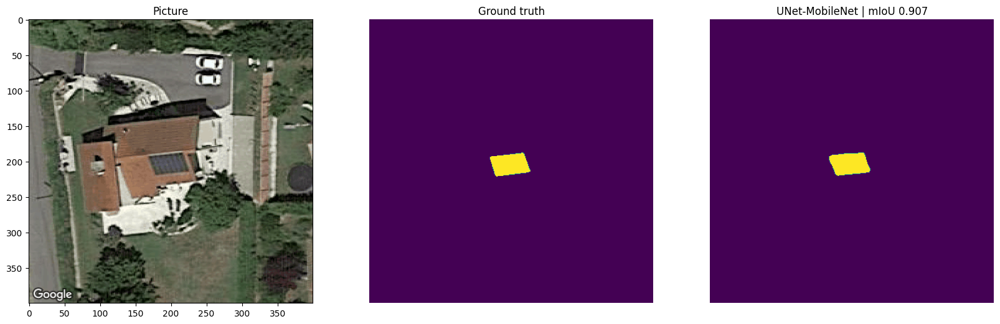

In [43]:
image, mask = test_set[3]
pred_mask, score = predict_image_mask_miou(model, image, mask, mean, std)

fig, (ax1, ax2, ax3) = plt.subplots(1,3, figsize=(20,10))
ax1.imshow(image)
ax1.set_title('Picture');

ax2.imshow(mask)
ax2.set_title('Ground truth')
ax2.set_axis_off()

ax3.imshow(pred_mask)
ax3.set_title('UNet-MobileNet | mIoU {:.3f}'.format(score))
ax3.set_axis_off()

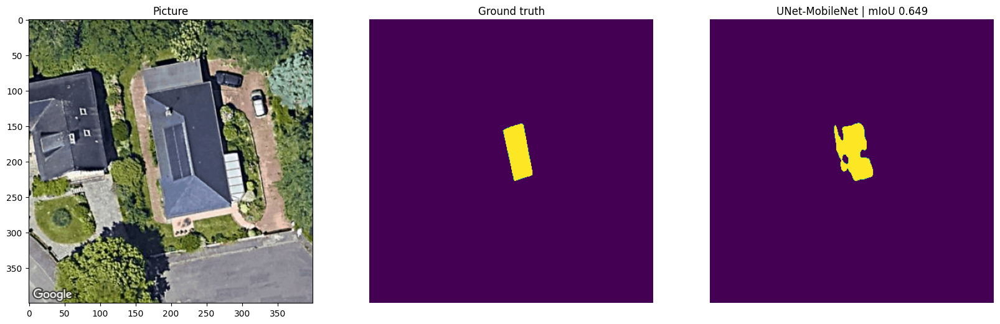

In [44]:
image2, mask2 = test_set[6]
pred_mask2, score2 = predict_image_mask_miou(model, image2, mask2, mean, std)

fig, (ax1, ax2, ax3) = plt.subplots(1,3, figsize=(20,10))
ax1.imshow(image2)
ax1.set_title('Picture');

ax2.imshow(mask2)
ax2.set_title('Ground truth')
ax2.set_axis_off()

ax3.imshow(pred_mask2)
ax3.set_title('UNet-MobileNet | mIoU {:.3f}'.format(score2))
ax3.set_axis_off()

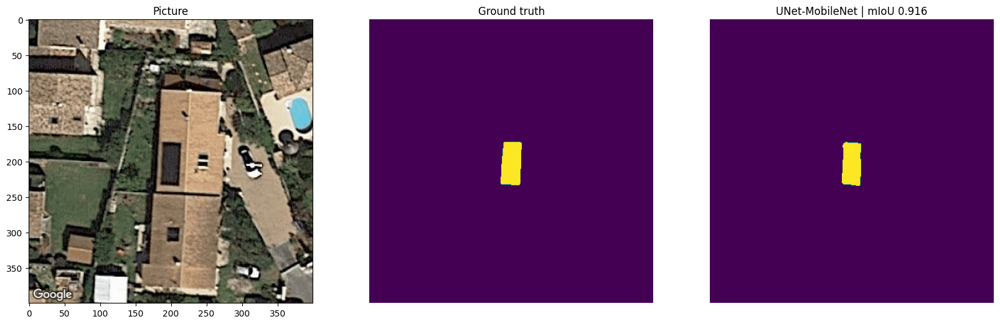

In [45]:
image3, mask3 = test_set[7]
pred_mask3, score3 = predict_image_mask_miou(model, image3, mask3, mean, std)

fig, (ax1, ax2, ax3) = plt.subplots(1,3, figsize=(20,10))
ax1.imshow(image3)
ax1.set_title('Picture');

ax2.imshow(mask3)
ax2.set_title('Ground truth')
ax2.set_axis_off()

ax3.imshow(pred_mask3)
ax3.set_title('UNet-MobileNet | mIoU {:.3f}'.format(score3))
ax3.set_axis_off()

In [46]:
#print('Test Set mIoU', np.mean(mob_miou))

In [47]:
#print('Train Set mIoU', np.mean(train_miou))

In [48]:
#print('Val Set mIoU', np.mean(val_miou))

In [49]:
#print('Test Set Probability of Detection', np.mean(mob_acc))

In [50]:
#print('Train Set Probability of Detection', np.mean(train_acc))

In [51]:
#print('Val Set Probability of Detection', np.mean(val_acc))

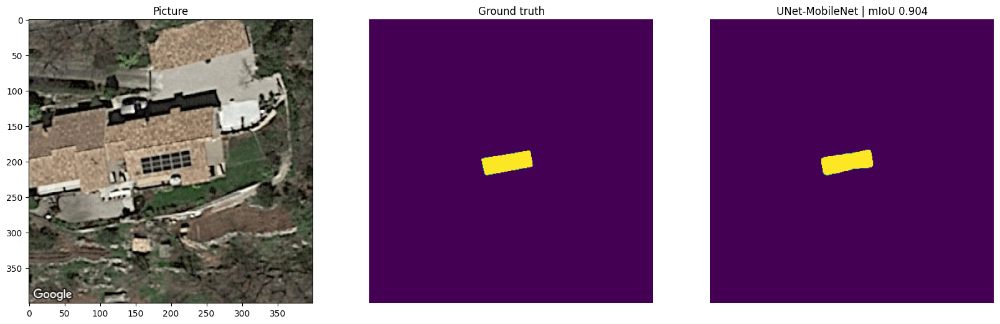

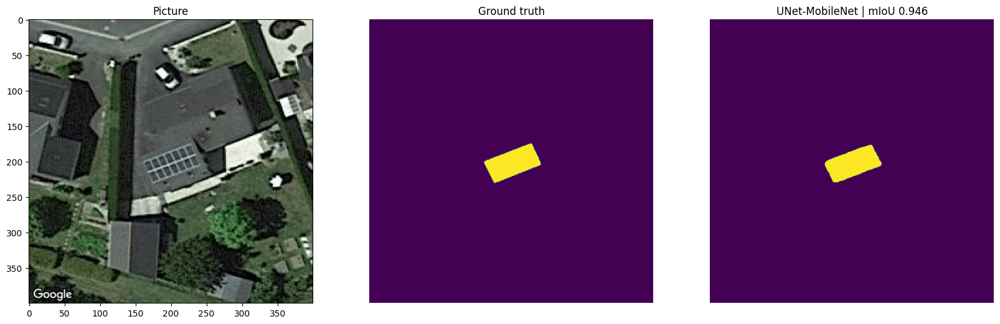

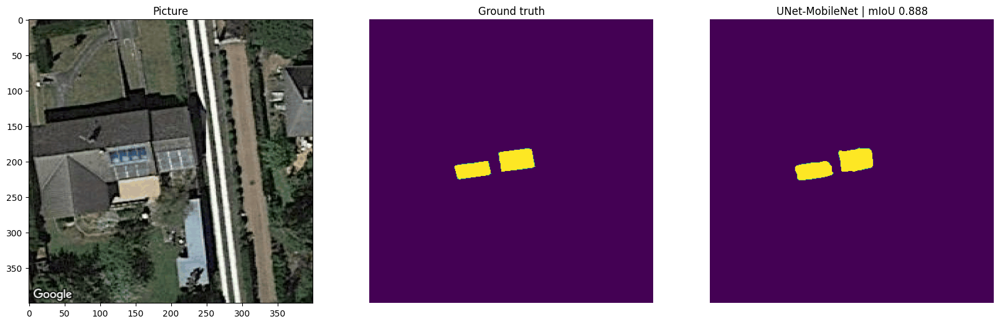

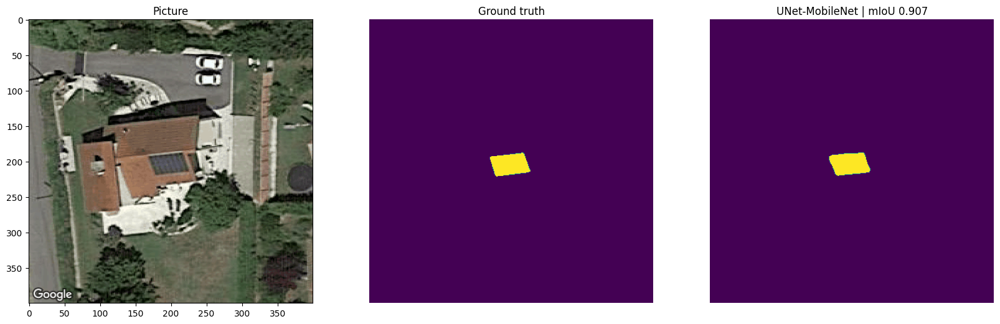

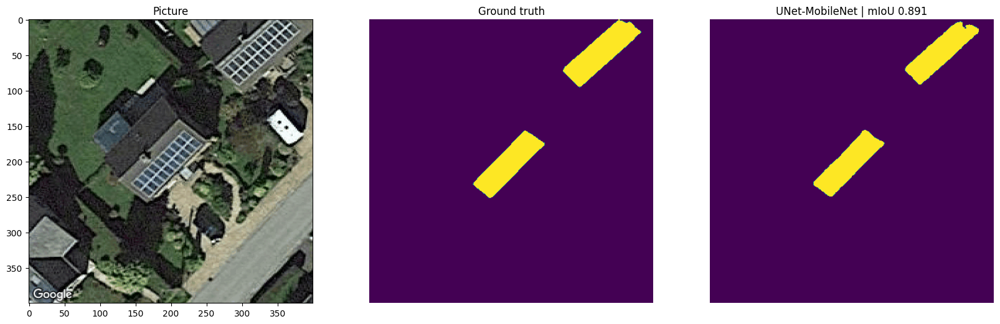

...

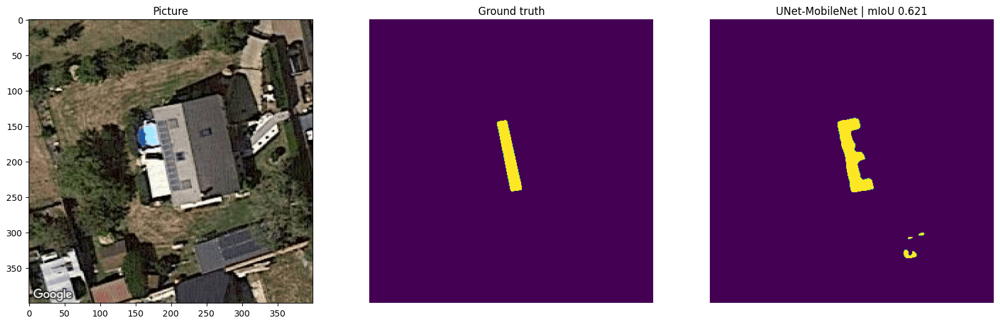

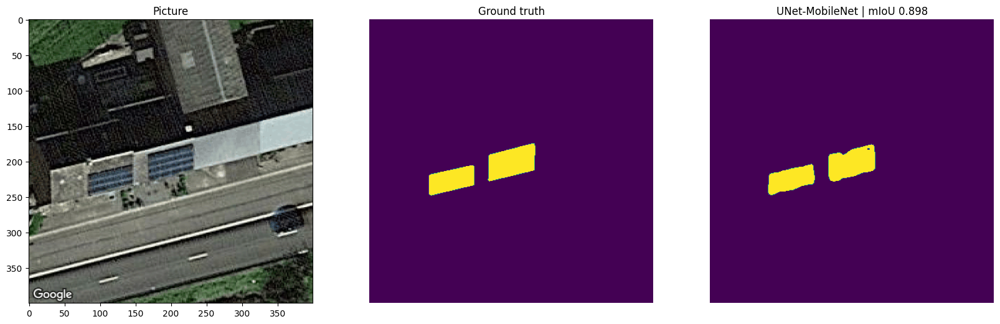

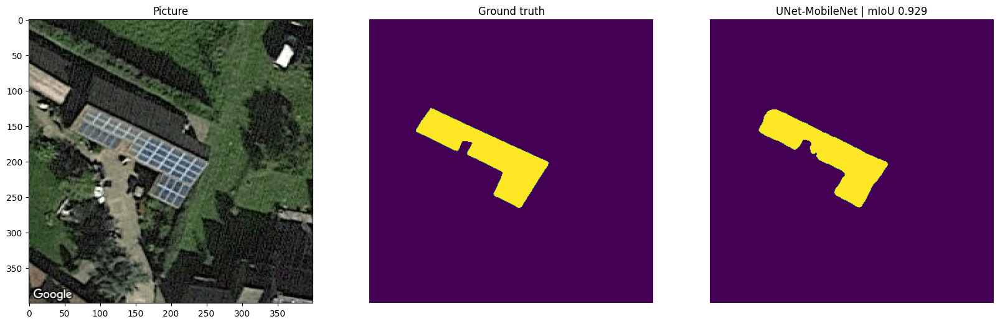

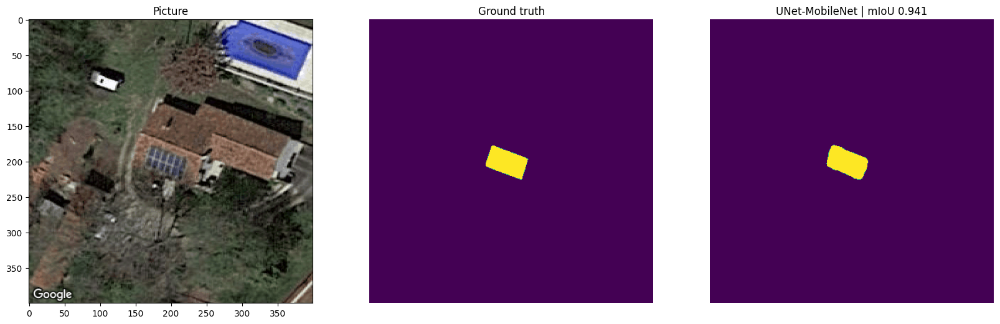

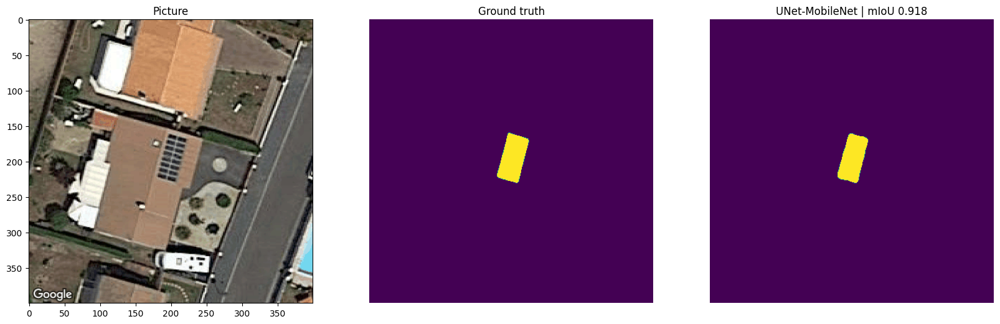

KeyboardInterrupt: 

In [52]:
for i in range(1331):

    image, mask = test_set[i]
    pred_mask, score = predict_image_mask_miou(model, image, mask, mean, std)
    fig, (ax1, ax2, ax3) = plt.subplots(1,3, figsize=(20,10))
    ax1.imshow(image)
    ax1.set_title('Picture')

    ax2.imshow(mask)
    ax2.set_title('Ground truth')
    ax2.set_axis_off()

    ax3.imshow(pred_mask)
    ax3.set_title('UNet-MobileNet | mIoU {:.3f}'.format(score))
    ax3.set_axis_off()

    plt.show()

    time.sleep(2)